In [71]:
import sys
import os
os.environ['PROJ_DATA'] = "/pscratch/sd/p/plutzner/proj_data"
import xarray as xr
import torch
import torchinfo
import random
import numpy as np
import importlib as imp
import pandas as pd
import matplotlib.pyplot as plt
import pickle
import cartopy.crs as ccrs
import json
import pickle
import gzip
import scipy
from scipy import stats
import gzip
#import matplotlib.colors as mcolorsxx

%load_ext autoreload
%autoreload 2
import utils
import utils.filemethods
from utils import utils

import databuilder.data_loader as data_loader
import databuilder.data_generator as data_generator
from databuilder.data_generator import ClimateData
from databuilder.data_generator import multi_input_data_organizer
import databuilder.data_loader as data_loader

import model.loss as module_loss
import model.metric as module_metric

from shash.shash_torch import Shash

from analysis.CRPS import crps_quadrature, _crps_single, CumulativeSum
from scipy.stats import rv_continuous
from scipy.interpolate import interp1d
from analysis.CRPS import _discover_bounds

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [72]:
config = utils.get_config("exp006")
seed = config["seed_list"][0]

In [73]:
# Setup the Data
front_cutoff = config["databuilder"]["front_cutoff"] # remove front nans : 74 ENSO - two front nans before daily interpolation = 60 days, daily interpolation takes 1/2 the original time step = 15 days TOTAL = ~75
back_cutoff = config["databuilder"]["back_cutoff"]  # remove back nans 

trainset = data_loader.CustomData(config["data_loader"]["data_dir"] + "/Network Inputs/exp006_train.pkl", front_cutoff, back_cutoff)
valset = data_loader.CustomData(config["data_loader"]["data_dir"] + "/Network Inputs/exp006_val.pkl", front_cutoff, back_cutoff)
testset = data_loader.CustomData(config["data_loader"]["data_dir"] + "/Network Inputs/exp006_test.pkl", front_cutoff, back_cutoff)


X1 shape: (60058, 3)
Target shape: (60058,)
X1 shape: (60058, 3)
Target shape: (60058,)
X1 shape: (60058, 3)
Target shape: (60058,)


Prepare Model and Target Data


In [74]:
# Open Model Outputs
model_output_pred = '/Users/C830793391/Documents/Research/E3SM/saved/output/exp006_output_pred_testset.pkl'
with gzip.open(model_output_pred, "rb") as obj1:
    output = pickle.load(obj1)

# Open Target Data (test set)
target_file = '/Users/C830793391/BIG_DATA/E3SM_Data/presaved/Network Inputs/exp006_test.pkl'
with gzip.open(target_file, "rb") as obj1:
    test_target = pickle.load(obj1)

test_target = test_target["y"][front_cutoff : -back_cutoff]

# SHORTEN SAMPLES FOR SPEED: 
# output = output[:20000, :]
# test_target = test_target[:20000]

In [75]:
# Establish SHASH PDF Distributions for All Samples:
x = np.arange(-50, 50, 0.0075)
dist = Shash(output)
p = dist.prob(x).numpy()
print(p.shape)

(13334, 60058)


Cumulative Sum Class: 

In [76]:
from analysis.CRPS import CumulativeSum
cumulative_sum = CumulativeSum(axis=1)
cdf = cumulative_sum(p, target = test_target, x_values=x)
assert callable(cdf)

cdf_array = CumulativeSum.cdf_array_output(p)

Normalizing input PDF array
cdf_array shape within CumulativeSum: (13334, 60058)
cdf_array last row: [1. 1. 1. ... 1. 1. 1.]


In [77]:
print(cdf_array.shape)

(13334, 60058)


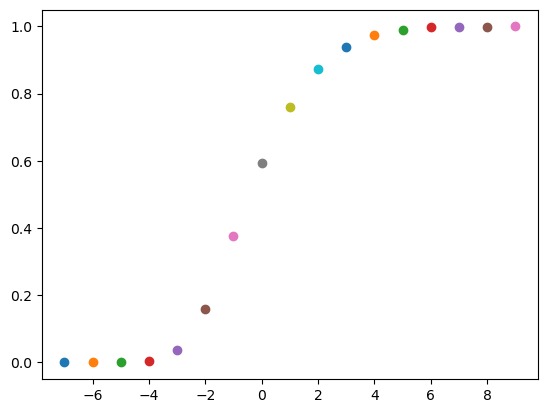

In [8]:
# example = cdf(-2, cdf_array[:,45454], x_values=x)
test_anomalies = [-7, -6, -5, -4, -3, -2, -1, 0, 1, 2, 3, 4, 5, 6, 7, 8, 9]
plt.figure()
for i in test_anomalies: 
    plt.scatter(i, cdf(i, cdf_array[:,1500], x_values=x))

#### Discover Bounds (ALL SAMPLES)

In [78]:
config = utils.get_config("exp006")
tol = config["databuilder"]["CRPS_tolerance"]
print(f"tolerance: {tol}")

bounds = _discover_bounds(cdf_array, x, tolerance =tol)

# Print the PPF values for a specific sample
sample = 10099
print(f"Upper and Lower Bounds for sample {sample}:", bounds[sample])

tolerance: 1e-07
The shape of the upper and lower distribution limits array is (60058, 2)
Upper and Lower Bounds for sample 10099: [-7.87095562 15.35175329]


### Calcualte CRPS (QUADRATURE)

/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:164: IntegrationWarning: The occurrence of roundoff error is detected, which prevents 
  the requested tolerance from being achieved.  The error may be 
  underestimated.
  rhs_int, rhs_tol = integrate.quad(rhs, target, xmax)
/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:167: UserWarning: Upper integral did not evaluate to within tolerance! 
Tolerance achieved: 0.000000 , Value of integral: 0.226714 
Consider setting the upper bound to np.inf or if you already have, set warn_level to `ignore`.
  warnings.warn('Upper integral did not evaluate to within tolerance! \n'
/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:152: IntegrationWarning: The occurrence of roundoff error is detected, which prevents 
  the requested tolerance from being achieved.  The error may be 
  underestimated.
  lhs_int, lhs_tol = integrate.quad(lhs, xmin, target)
/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:159: UserWarning: Lower

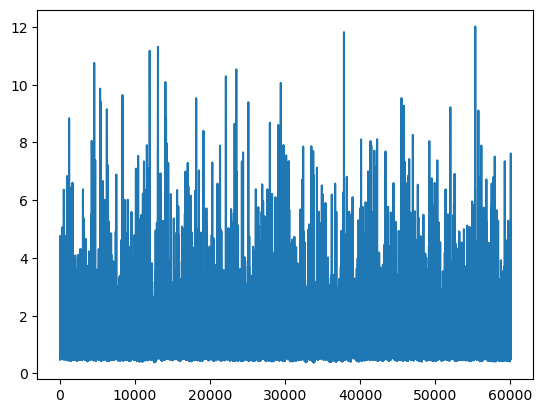

In [79]:
# print(type(cdf))
# print(callable(cdf))
CRPS = np.zeros(len(test_target))
for i, target in enumerate(test_target):
    CRPS[i] = _crps_single(test_target[i], cdf, cdf_array[:,i], x, xmin = bounds[i,0], xmax= bounds[i,1], tol=tol)

plt.figure()
plt.plot(CRPS)

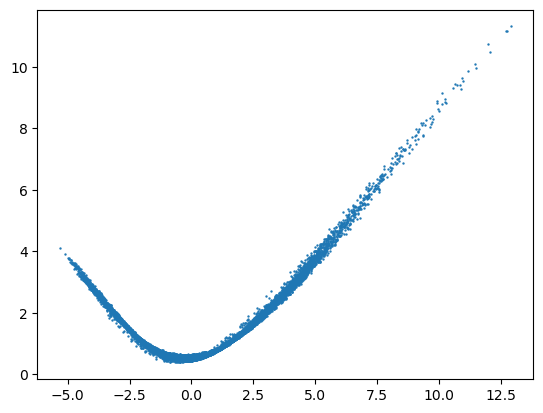

In [40]:
plt.figure()
plt.scatter(test_target, CRPS, s=0.5)

In [81]:
CRPS_savename = '/Users/C830793391/Documents/Research/E3SM/saved/output/exp006_CRPS_testset_allsamples.pkl'
with gzip.open(CRPS_savename, "wb") as fp:
    pickle.dump(CRPS, fp)

with gzip.open('/Users/C830793391/Documents/Research/E3SM/saved/output/exp006_CRPS_testset_allsamples.pkl', "rb") as obj1:
    crps_scores = pickle.load(obj1)

--------------------------------------------------------------------

In [86]:
from analysis.climatology import crps_climatology
preprocessed_fname = "/Users/C830793391/BIG_DATA/E3SM_Data/presaved/Network Inputs/exp006_test.pkl"
climatology_array = crps_climatology(test_target, x, preprocessed_fname)

Climatological Mean = 0.00018667661056060916
Climatological Variance = 4.781010465471961
(13333, 60058)


In [82]:
from analysis.climatology import crps_climatology
preprocessed_fname = "/Users/C830793391/BIG_DATA/E3SM_Data/presaved/Network Inputs/exp006_test.pkl"
climatology_array = crps_climatology(test_target, x, preprocessed_fname)

config = utils.get_config("exp006")
tol = config["databuilder"]["CRPS_tolerance"]
print(f"tolerance: {tol}")

bounds = _discover_bounds(climatology_array, x[:len(climatology_array)], tolerance =tol)

#crps(cdf_base, test_target[:20000], x, climatology)

CRPS_clima = np.zeros(len(test_target))
for i, target in enumerate(test_target):
    CRPS_clima[i] = _crps_single(test_target[i], cdf, climatology_array[:,i], x, xmin = bounds[i,0], xmax= bounds[i,1], tol=tol)

Climatologial Mean = 0.00018667661056060916
(13333, 60058)
tolerance: 1e-07
The shape of the upper and lower distribution limits array is (60058, 2)


/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:152: IntegrationWarning: The maximum number of subdivisions (50) has been achieved.
  If increasing the limit yields no improvement it is advised to analyze 
  the integrand in order to determine the difficulties.  If the position of a 
  local difficulty can be determined (singularity, discontinuity) one will 
  probably gain from splitting up the interval and calling the integrator 
  on the subranges.  Perhaps a special-purpose integrator should be used.
  lhs_int, lhs_tol = integrate.quad(lhs, xmin, target)
/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:167: UserWarning: Upper integral did not evaluate to within tolerance! 
Tolerance achieved: 0.000062 , Value of integral: 0.210882 
Consider setting the upper bound to np.inf or if you already have, set warn_level to `ignore`.
  warnings.warn('Upper integral did not evaluate to within tolerance! \n'
/Users/C830793391/Documents/Research/E3SM/model/CRPS.py:167: UserWarni

In [83]:
CRPS_clima_savename = '/Users/C830793391/Documents/Research/E3SM/saved/output/exp006_CRPS_climatology_testset_allsamples.pkl'
with gzip.open(CRPS_clima_savename, "wb") as fp:
    pickle.dump(CRPS_clima, fp)

In [84]:
print(f"Climatology Mean CRPS Score: {round(CRPS_clima.mean(), 5)}")
print(f"Network Mean CRPS Score: {round(crps_scores.mean(), 5)}")

print(f"Difference between scores: {round(CRPS_clima.mean() - crps_scores.mean(), 5)} \n")

print("Conclusion: The network is BETTER than climatology by 0.0045")

Climatology Mean CRPS Score: 1.19635
Network Mean CRPS Score: 1.19181
Difference between scores: 0.00454 

Conclusion: The network is worse than climatology by 0.005


------------------------------------------------------------

Check CRPS -> MAE with narrow distribution: 

[[0.0e+00 5.0e-04 0.0e+00 1.0e+00]
 [0.0e+00 9.0e-05 0.0e+00 1.0e+00]
 [0.0e+00 1.0e-03 0.0e+00 1.0e+00]
 [0.0e+00 1.0e-02 0.0e+00 1.0e+00]
 [0.0e+00 3.3e-04 0.0e+00 1.0e+00]
 [0.0e+00 4.0e-03 0.0e+00 1.0e+00]]
Normalizing input PDF array
cdf_array shape within CumulativeSum: (2667, 6)
cdf_array last row: [1. 1. 1. 1. 1. 1.]
(6,)
(2667,)
(2667, 6)


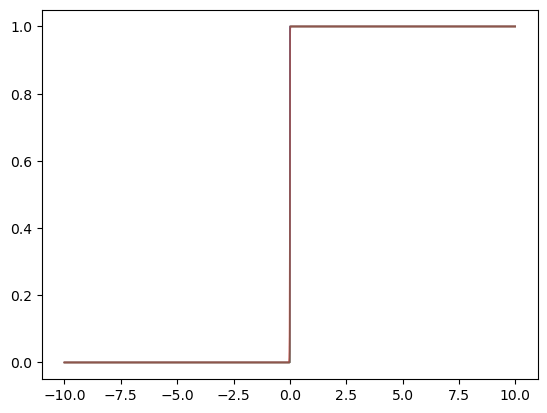

In [58]:
x_narrow = np.arange(-10, 10, 0.0075)

narrow_shash = np.array([(0, 0.0005, 0, 1), (0, 0.00009, 0, 1), (0, 0.001, 0, 1), (0, 0.01, 0, 1), (0, 0.00033, 0, 1), (0, 0.004, 0, 1)])
print(narrow_shash)
p_narrow = Shash(narrow_shash).prob(x_narrow).numpy()

target_narrow = np.array([-1, 8, -3, 0, 5, 2])

from analysis.CRPS import CumulativeSum
cumulative_sum = CumulativeSum(axis=1)
cdf = cumulative_sum(p_narrow, target = target_narrow, x_values=x_narrow)
assert callable(cdf)

cdf_array_narrow = CumulativeSum.cdf_array_output(p_narrow)

print(target_narrow.shape)
print(x_narrow.shape)
print(cdf_array_narrow.shape)

The shape of the upper and lower distribution limits array is (6, 2)
[[-0.01       -0.0025    ]
 [-0.01       -0.0025    ]
 [-0.01        0.00499116]
 [-0.05496375  0.04946187]
 [-0.01       -0.0025    ]
 [-0.02498604  0.01973204]]


Text(0.5, 0, 'Target')

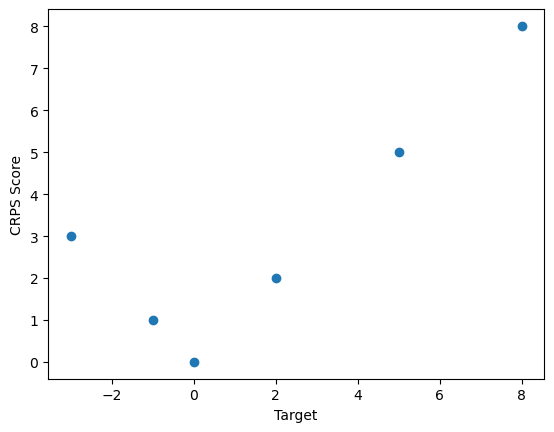

In [59]:
tol = config["databuilder"]["CRPS_tolerance"]

bounds_narrow = _discover_bounds(cdf_array_narrow, x_narrow, tolerance =tol)

print(bounds_narrow)

CRPS_narrow = np.zeros(len(target_narrow))
for i, target in enumerate(target_narrow):
    CRPS_narrow[i] = _crps_single(target, cdf, cdf_array_narrow[:,i], x_narrow, xmin = bounds_narrow[i,0], xmax= bounds_narrow[i,1], tol=tol)

plt.figure()
plt.scatter(target_narrow, CRPS_narrow)
plt.ylabel("CRPS Score")
plt.xlabel("Target")